<a href="https://colab.research.google.com/github/duchaba/Data-Augmentation-with-Python/blob/main/data_augmentation_with_python_chapter_8_with_output.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 🌻 Welcome to Chapter 8, Audio Data Augmentation with Spectrogram


---

I am glad to see you using this Python Notebook. 🐶

The Python Notebook is an integral part of the book. You can add new “code cells” to extend the functions, add your data, and explore new possibilities, such as downloading additional real-world datasets from the Kaggle website and coding the **Fun challenges**. Furthermore, the book has **Fun facts**, in-depth discussion about augmentation techniques, and Pluto, an imaginary Siberian Huskey coding companion. Together they will guide you every steps of the way. 

Pluto encourages you to copy or save a copy of this Python Notebook to your local space and add the “text cells” to keep your notes. In other words, read the book and copy the relevant concept to this Python Notebook’s text-cells. Thus, you can have the explanation, note, original code, your code, and any crazy future ideas in one place.  


💗 I hope you enjoy reading the book and hacking code as much as I enjoy writing it. 


## 🌟 Amazon Book

---

- The book is available on the Amazon Book website: 
  - https://www.amazon.com/dp/1803246456

  - Author: Duc Haba
  - Published: 2023
  - Page count: 390+


- The original Python Notebook is on: 
  - https://github.com/PacktPublishing/Data-Augmentation-with-Python/blob/main/Chapter_8/data_augmentation_with_python_chapter_8.ipynb 

- 🚀 Click on the blue "Open in Colab" button at the top of this page to begin hacking.


# 😀 Excerpt from Chapter 8, Audio Data Augmentation with Spectrogram

---

> In case you haven’t bought the book. Here is an teaser from the first page of Chapter 8.

---


In the previous chapter, we visualized the sound using the Waveform graph. An audio spectrogram is another visualizing method to see the audio components. The inputs to the Spectrogram are a one-dimensional array of amplitude values and the sampling rate. They are the same inputs as the Waveform graph.

An audio Spectrogram is sometimes called a sonograph, sonogram, voiceprint, or voicegram. The Spectrogram is a more detailed representation of sound than the Waveform graph. It shows a correlation between frequency and amplitude (loudness) over time, which helps visualize the frequency content in a signal. Spectrogram makes it easier to identify musical elements, detect melodic patterns, recognize frequency-based effects, and compare the results of different volume settings. Additionally, the Spectrogram can be more helpful in identifying non-musical aspects of a signal, such as noise and interference from other frequencies.

The typical usage is for music, human speech, and sonar. A short standard definition is a spectrum of frequency maps with time duration. In other words, the y axis is the frequency in Hz or kHz, and the x axis is the time duration in seconds or milliseconds. Sometimes, the graph comes with a color index for the amplitude level.

Pluto will explain the code in the Python Notebook later in the chapter, but here is a sneak peek of an audio Spectrogram. The command for drawing the control piano scale in the D major audio file is as follows:


> skip...image...

Before Pluto demystifies the audio Spectrogram, you should review Chapter 7 if the audio concepts and keywords sound alien to you. Chapter 8 relies heavily on the knowledge and practices in Chapter 7.

In Figure 8.1, Pluto uses the Matplotlib library to draw the audio Spectrogram. The primary input is the amplitude array and the sampling rate. The library does all the heavy calculations, and other libraries, such as the Librosa or the SciPy library, can perform the same task. In particular, Matplotlib can generate many types of audio Spectrogram from the same input. Pluto will dig deeper into types of Spectrogram a bit later, but first, let’s break down the steps of how the library constructs an audio Spectrogram. The five high-level tasks are as follows:

1. Splitting the audio stream into overlapping segments, also known as windows.

2. Calculating the Short Time Fourier Transformation (STFT) value on each window.

3. Converting the windows’ value into decibels (dB).

4. Linking the windows together as in the original audio sequence.

5. Displaying the result in a graph with the y axis as Hz, the x axis as seconds, and dB as a color-coded value.

The math for the previous five steps is complex, and the chapter’s goal is to use a Spectrogram to visualize the sound and augment the audio file. Thus, we rely on audio libraries to perform the math calculation.

As mentioned, the underlying data representing the Spectrogram is the same as the Waveform format. Therefore, the audio augmentation techniques are the same. Consequently, the resulting augmented audio file will sound the same. The visual representation is the only difference between the Spectrogram and the Waveform graph.

The majority of this chapter will cover the audio Spectrogram standard format, variation of a Spectrogram, Mel-spectrogram, and Chroma STFT. The augmentation techniques represent a shorter section because you have learned the method in the previous chapter. We will cover the following topics in this chapter:

- Initialize and download

- Audio Spectrogram

- Various Spectrogram formats

- Mel-spectrogram and Chroma STFT

- Spectrogram augmentation

- Spectrogram image


---

🌴 *end of excerpt from the book*

# GitHub Clone

In [1]:
# git version should be 2.17.1 or higher
!git --version

git version 2.25.1


In [2]:
url = 'https://github.com/PacktPublishing/Data-Augmentation-with-Python'
!git clone {url}

Cloning into 'Data-Augmentation-with-Python'...
remote: Enumerating objects: 162, done.
remote: Counting objects: 100% (140/140), done.
remote: Compressing objects: 100% (92/92), done.
remote: Total 162 (delta 73), reused 107 (delta 47), pack-reused 22
Receiving objects: 100% (162/162), 13.24 MiB | 6.21 MiB/s, done.
Resolving deltas: 100% (73/73), done.


In [3]:
# (optional) list the notebook magic commands
# %lsmagic

## Fetch file from URL (Optional)

- Uncommend the below 2 code cells if you want to use URL and not Git Clone

In [4]:
# import requests
# #
# def fetch_file(url, dst):
#   downloaded_obj = requests.get(url)
#   with open(dst, "wb") as file:
#     file.write(downloaded_obj.content)
#   return

In [5]:
# url = ''
# dst = 'pluto_chapter_1.py'
# fetch_file(url,dst)

# Run Pluto

- Instantiate up Pluto, aka. "Pluto, wake up!"

In [6]:
# %% CARRY-OVER code install

!pip install opendatasets --upgrade
!pip install pyspellchecker 
!pip install audiomentations


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 37.8 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.1/66.1 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.3/214.3 kB 29.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 100.9 MB/s eta 0:00:00
  Attempting uninstall: librosa
    Found existing installation: librosa 0.10.0.post2
    Uninstalling librosa-0.10.0.post2:
      Successfully uninstalled librosa-0.10.0.post2


In [7]:
#load and run the pluto chapter 7 Python code.
pluto_file = 'Data-Augmentation-with-Python/pluto/pluto_chapter_7.py'
%run {pluto_file}

---------------------------- : ----------------------------
            Hello from class : <class '__main__.PacktDataAug'> Class: PacktDataAug
                   Code name : Pluto
                   Author is : Duc Haba
---------------------------- : ----------------------------


## Verify Pluto

In [8]:
pluto.say_sys_info()

---------------------------- : ----------------------------
                 System time : 2023/04/26 22:35
                    Platform : linux
     Pluto Version (Chapter) : 7.0
             Python (3.7.10) : actual: 3.9.16 (main, Dec  7 2022, 01:11:51) [GCC 9.4.0]
            PyTorch (1.11.0) : actual: 2.0.0+cu118
              Pandas (1.3.5) : actual: 1.5.3
                 PIL (9.0.0) : actual: 8.4.0
          Matplotlib (3.2.2) : actual: 3.7.1
                   CPU count : 2
                   CPU speed : 2.00 GHz
               CPU max speed : 0.00 GHz
---------------------------- : ----------------------------


In [9]:
# # (optional) list attributes, function, and everything else
# dir(pluto)

## (Optional) Export to .py

In [10]:
pluto_chapter_8 = 'Data-Augmentation-with-Python/pluto/pluto_chapter_8.py'
!cp {pluto_file} {pluto_chapter_8}

# ✋ Set up Kaggle username and app Key

- Install the following libraries, and import it on the Notebook.
- Follow by initialize Kaggle username, key and fetch methods.

- STOP: Update your Kaggle access username or key first.

In [11]:
# %%CARRY-OVER code 

# -------------------- : --------------------
# READ ME
# Chapter 2 begin:
# Install the following libraries, and import it on the Notebook.
# Follow by initialize Kaggle username, key and fetch methods.
# STOP: Update your Kaggle access username or key first.
# -------------------- : --------------------
#
!pip install opendatasets --upgrade
import opendatasets
print("\nrequired version 0.1.22 or higher: ", opendatasets.__version__)
#
!pip install pyspellchecker 
import spellchecker
print("\nRequired version 0.7+", spellchecker.__version__)
#
# STOP: Update your Kaggle access username or key first.
pluto.remember_kaggle_access_keys("YOUR_KAGGLE_USERNAME", "YOUR_KAGGLE_KEY")
pluto._write_kaggle_credit()
import kaggle
#
@add_method(PacktDataAug)
def fetch_kaggle_comp_data(self,cname):
  #self._write_kaggle_credit()  # need to run only once.
  path = pathlib.Path(cname)
  kaggle.api.competition_download_cli(str(path))
  zipfile.ZipFile(f'{path}.zip').extractall(path)
  return
#
@add_method(PacktDataAug)
def fetch_kaggle_dataset(self,url,dest="kaggle"):
  #self._write_kaggle_credit()    # need to run only once.
  opendatasets.download(url,data_dir=dest)
  return
# -------------------- : --------------------


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

required version 0.1.22 or higher:  0.1.22
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/

Required version 0.7+ 0.7.2


# Fetch Kaggle Data

## Musical Emotions Classification

In [12]:
%%time
url = 'https://www.kaggle.com/datasets/kingofarmy/musical-emotions-classification'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 641M/641M [00:32<00:00, 20.6MB/s]



CPU times: user 6.02 s, sys: 2.26 s, total: 8.29 s
Wall time: 39.6 s


In [13]:
f = 'kaggle/musical-emotions-classification/Train.csv'
pluto.df_music_data = pluto.fetch_df(f)
pluto.df_music_data.head(3)

,GroupID,ImageID,Target,Shapes
0,Happy102,Happy10200.wav,Happy,220608
1,Happy102,Happy10201.wav,Happy,220608
2,Happy102,Happy10202.wav,Happy,220608


In [14]:
# %%writefile -a {pluto_chapter_7}

pluto.version = 7.0
# augment full path
@add_method(PacktDataAug)
def _append_music_full_path(self,x):
  y = re.findall('([a-zA-Z ]*)\d*.*', x)[0]
  return (f'kaggle/musical-emotions-classification/Audio_Files/Audio_Files/Train/{y}/{x}')
#
@add_method(PacktDataAug)
def fetch_music_full_path(self, df):
  df['fname'] = df.ImageID.apply(self._append_music_full_path)
  return df

In [15]:
pluto.fetch_music_full_path(pluto.df_music_data)
pluto.df_music_data.head(3)

,GroupID,ImageID,Target,Shapes,fname
0,Happy102,Happy10200.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...
1,Happy102,Happy10201.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...
2,Happy102,Happy10202.wav,Happy,220608,kaggle/musical-emotions-classification/Audio_F...


## Human Speech

In [16]:
%%time
url = 'https://www.kaggle.com/datasets/ejlok1/cremad'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 451M/451M [00:23<00:00, 20.2MB/s]



CPU times: user 6.44 s, sys: 2.06 s, total: 8.5 s
Wall time: 30.8 s


In [17]:
# change method name to make_dir_dframe
f = 'kaggle/cremad/AudioWAV'
pluto.df_voice_data = pluto.make_dir_dataframe(f)
pluto.df_voice_data.head(3)

Streaming output truncated to the last 5000 lines.
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, igno

,fname,label
0,kaggle/cremad/AudioWAV/1074_IOM_DIS_XX.wav,AudioWAV
1,kaggle/cremad/AudioWAV/1084_TAI_DIS_XX.wav,AudioWAV
2,kaggle/cremad/AudioWAV/1013_IEO_NEU_XX.wav,AudioWAV


In [18]:
pluto.df_voice_data.head(3)

,fname,label
0,kaggle/cremad/AudioWAV/1074_IOM_DIS_XX.wav,AudioWAV
1,kaggle/cremad/AudioWAV/1084_TAI_DIS_XX.wav,AudioWAV
2,kaggle/cremad/AudioWAV/1013_IEO_NEU_XX.wav,AudioWAV


## Urban sound

In [19]:
%%time
url = 'https://www.kaggle.com/datasets/rupakroy/urban-sound-8k'
pluto.fetch_kaggle_dataset(url)

100%|██████████| 5.61G/5.61G [04:46<00:00, 21.0MB/s]



CPU times: user 1min 4s, sys: 21.9 s, total: 1min 26s
Wall time: 5min 54s


In [20]:
# 
# change method name to make_dir_dframe
f = 'kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8K/audio'
pluto.df_sound_data = pluto.make_dir_dataframe(f)
pluto.df_sound_data.head(3)

Streaming output truncated to the last 5000 lines.
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, ignore_index=True)
/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:199: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(d, igno

,fname,label
0,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold3
1,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold3
2,kaggle/urban-sound-8k/UrbanSound8K/UrbanSound8...,fold3


# Audio control D Major

In [21]:
# %%writefile -a {pluto_chapter_7}

f = 'Data-Augmentation-with-Python/pluto_data/control-d-major.mp3'
data_amp, sam_rate, fname = pluto._fetch_audio_data(f)
pluto.audio_control_dmajor = [data_amp, sam_rate, fname, f]

# Double check on Waveform graph

/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:345: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


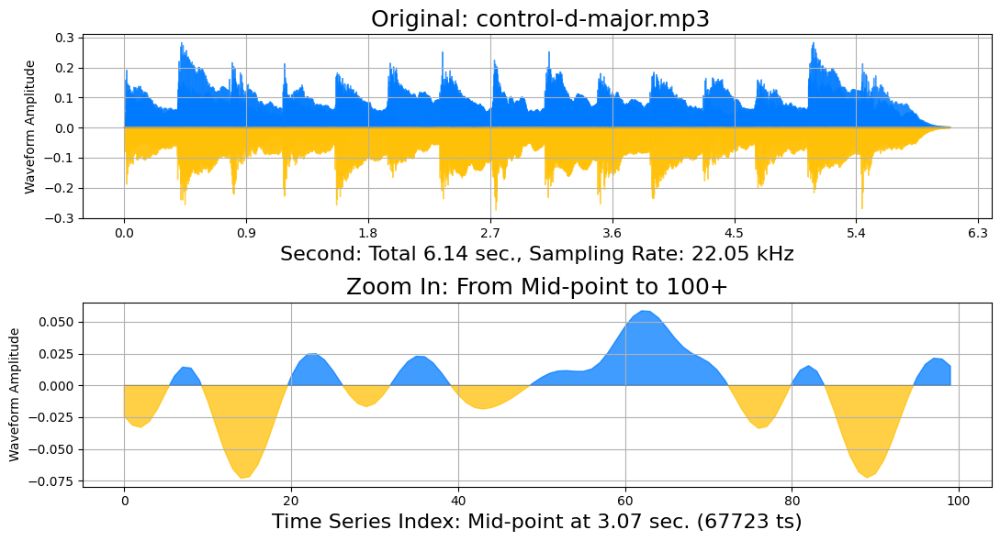

In [22]:
# double check on waveform graph from previous chapter
pluto._draw_audio(data_amp, sam_rate, 'Original: ' + fname)
# display audio 
display(IPython.display.Audio(data_amp, rate=sam_rate))

# Spectrogram

In [23]:
# %%writefile -a {pluto_chapter_8}

@add_method(PacktDataAug)
def _draw_spectrogram(self, data_amp, sam_rate, 
  fname='Spectrogram',
  window=matplotlib.mlab.window_hanning,
  cmap='viridis',
  sides='default',
  mode='default'):
  canvas, pic = matplotlib.pyplot.subplots(1, 1, figsize=(11, 5))
  spec, freq, ts, ax = pic.specgram(data_amp, 
    Fs=sam_rate,
    window=window,
    cmap=cmap,
    sides=sides,
    mode=mode)
  pic.set_xlabel('Time, Sampling Rate: '+str(sam_rate),fontsize=16.)
  pic.set_ylabel('Frequency (Hz)',fontsize=16.)
  pic.set_title(fname,fontsize=18.0)
  #
  # display and save image
  canvas.tight_layout()
  self._drop_image(canvas)
  canvas.show()
  return spec, freq, ts, ax

In [24]:
# %%writefile -a {pluto_chapter_8}

@add_method(PacktDataAug)
def draw_spectrogram(self, df,
  fname='Spectrogram',
  window=matplotlib.mlab.window_hanning,
  cmap='viridis',
  sides='default',
  mode='default'):
  if (type(df) is list):
    data_amp, sam_rate, fname, lname = df
  else:
    lname = self._fetch_1_sample(df)
    data_amp, sam_rate, fname = self._fetch_audio_data(lname)
  #
  spec, freq, ts, ax = self._draw_spectrogram(data_amp, sam_rate,
    fname='Spectrogram: '+fname,
    window=window,
    cmap=cmap,
    sides=sides,
    mode=mode)
  # display audio 
  display(IPython.display.Audio(data_amp,rate=sam_rate))
  return
#
@add_method(PacktDataAug)
def _draw_melspectrogram(self, mel_db, sam_rate, data_amp,
  fname='MelSpectrogram',
  cmap='viridis',
  y_axis='mel',
  y_label='Mel scale (Hz)'):
  canvas, pic = matplotlib.pyplot.subplots(1, 1, figsize=(11, 5))
  #
  img = librosa.display.specshow(mel_db, 
    sr=sam_rate,
    x_axis='time',
    y_axis=y_axis,
    fmax=8000, 
    ax=pic,
    cmap=cmap)
  canvas.colorbar(img, ax=pic, format='%+2.0f dB')
  #
  pic.set_xlabel('Time, Sampling Rate: '+str(sam_rate),fontsize=16.)
  pic.set_ylabel(y_label,fontsize=16.)
  pic.set_title(fname,fontsize=18.0)
  #
  # display and save image
  canvas.tight_layout()
  self._drop_image(canvas)
  canvas.show()
  # display audio 
  display(IPython.display.Audio(data_amp,rate=sam_rate))
  return
#
@add_method(PacktDataAug)
def draw_melspectrogram(self, df,
  fname='MelSpectrogram',
  cmap='viridis',
  is_chroma=False):
  if (type(df) is list):
    data_amp, sam_rate, fname, lname = df
  else:
    lname = self._fetch_1_sample(df)
    data_amp, sam_rate, fname = self._fetch_audio_data(lname)
  #
  if (is_chroma):
    mel_db = librosa.feature.chroma_stft(data_amp, 
      sr=sam_rate)
    yax = 'chroma'
    ylab = 'Pitch class'
    tname = 'Chroma STFT: ' + fname
  else:
    mel = librosa.feature.melspectrogram(y=data_amp, 
    sr=sam_rate, 
    n_mels=128,
    fmax=8000)
    mel_db = librosa.power_to_db(mel, ref=numpy.max)
    yax = 'mel'
    ylab = 'Mel scale (Hz)'
    tname = 'Melspectrogram: ' + fname
  #
  self._draw_melspectrogram(mel_db, sam_rate, data_amp,
    cmap=cmap,
    fname=tname,
    y_axis=yax,
    y_label = ylab)
  return
#

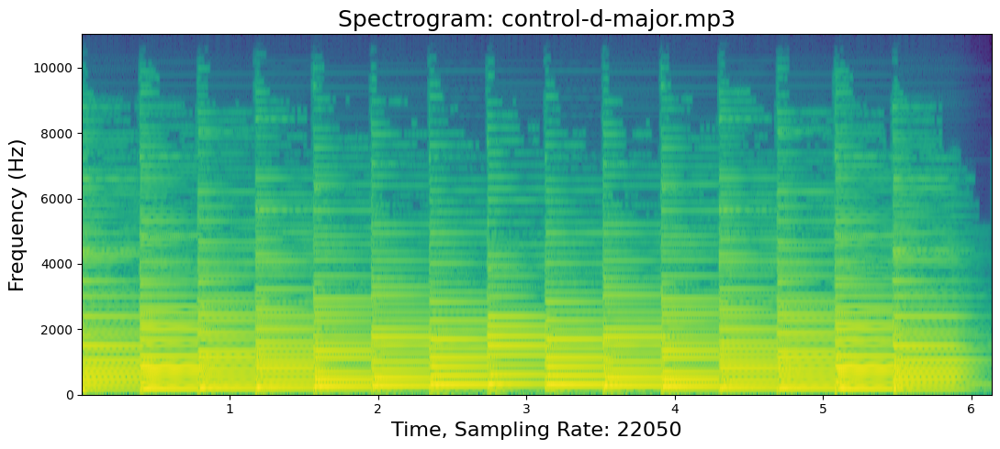

In [25]:
pluto.draw_spectrogram(pluto.audio_control_dmajor)

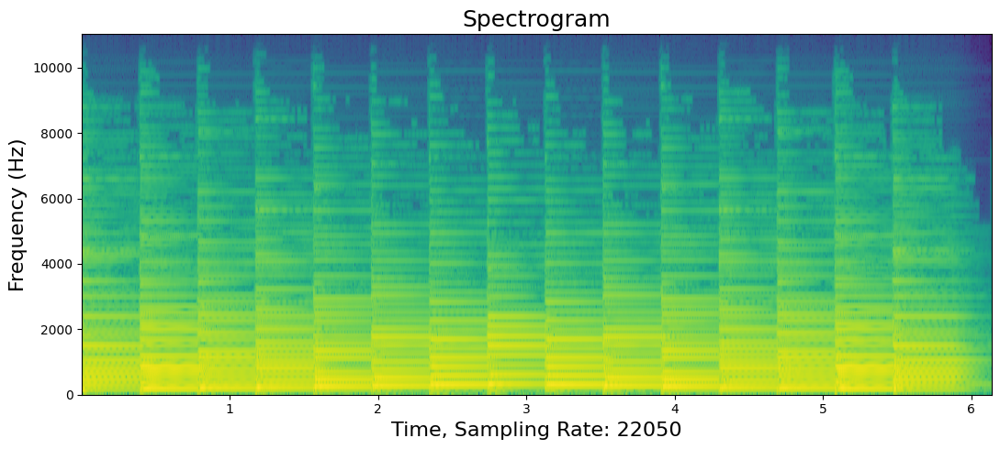

In [26]:
spec, freq, ts, ax = pluto._draw_spectrogram(pluto.audio_control_dmajor[0], pluto.audio_control_dmajor[1])

## Spectrogram parameters

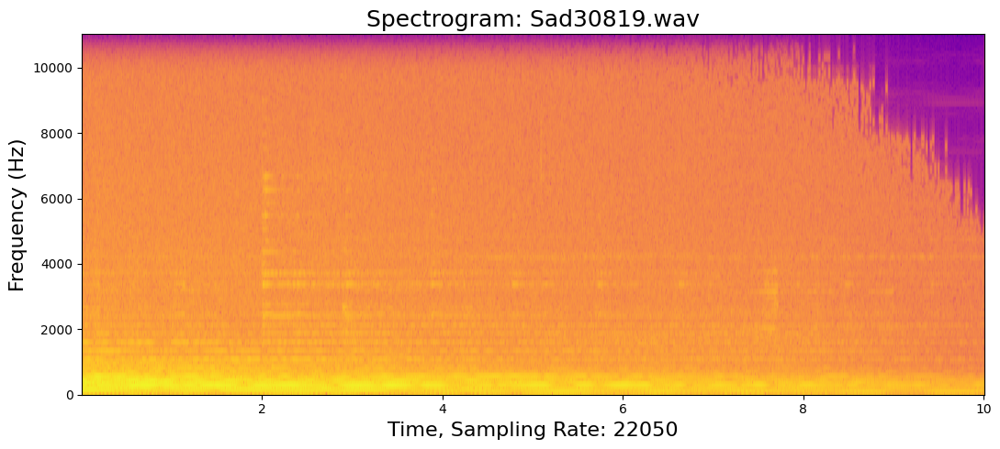

In [27]:
pluto.draw_spectrogram(pluto.df_music_data, cmap='plasma')

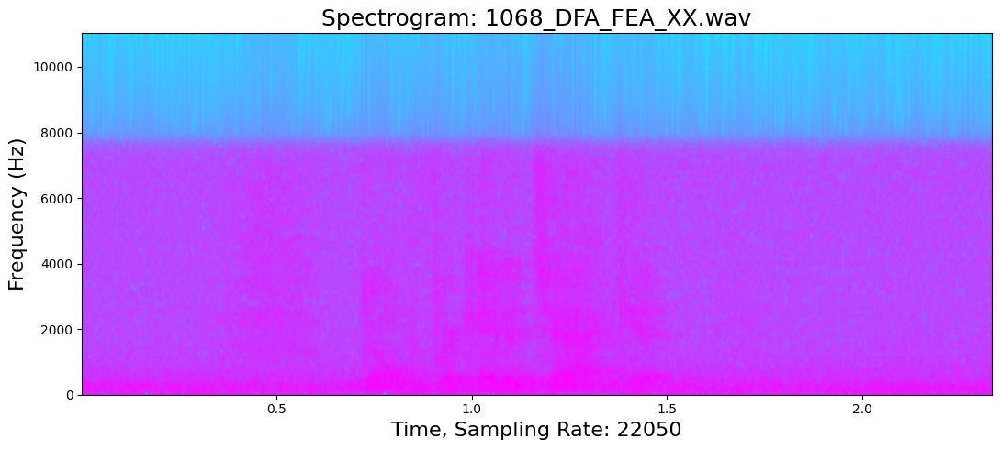

In [28]:
pluto.draw_spectrogram(pluto.df_voice_data, cmap='cool')

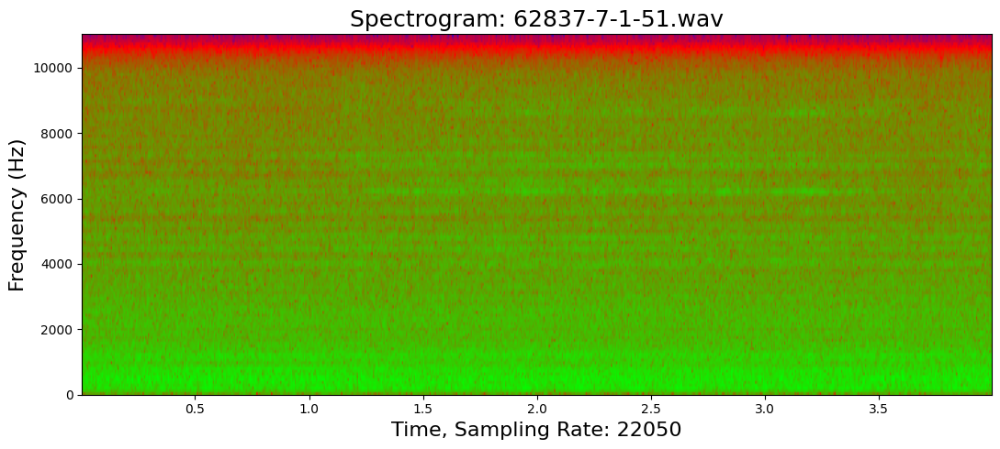

In [29]:
pluto.draw_spectrogram(pluto.df_sound_data, cmap='brg')

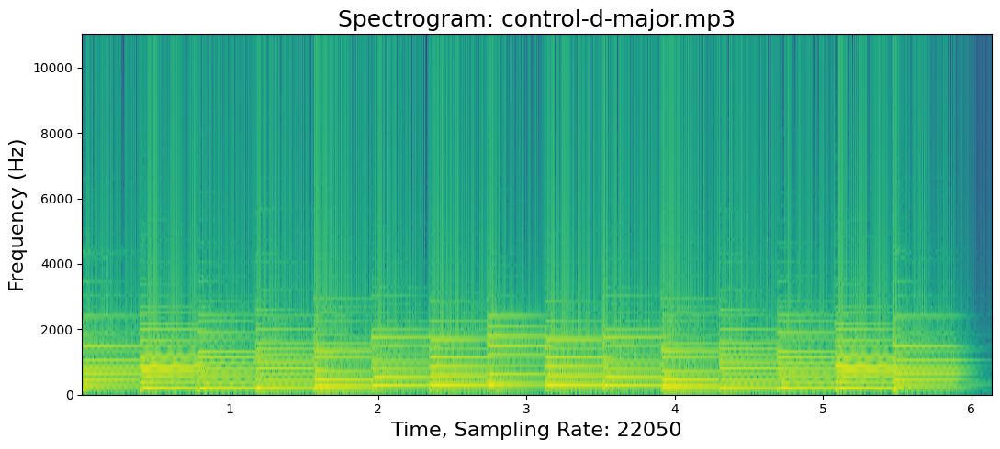

In [30]:
pluto.draw_spectrogram(pluto.audio_control_dmajor,
  window=matplotlib.mlab.window_none)

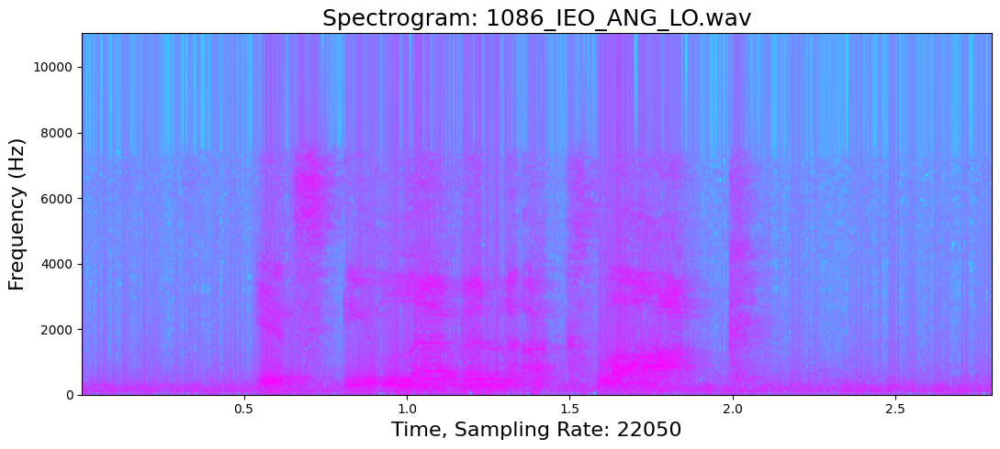

In [31]:
pluto.draw_spectrogram(pluto.df_voice_data,
  cmap='cool',
  window=matplotlib.mlab.window_none)

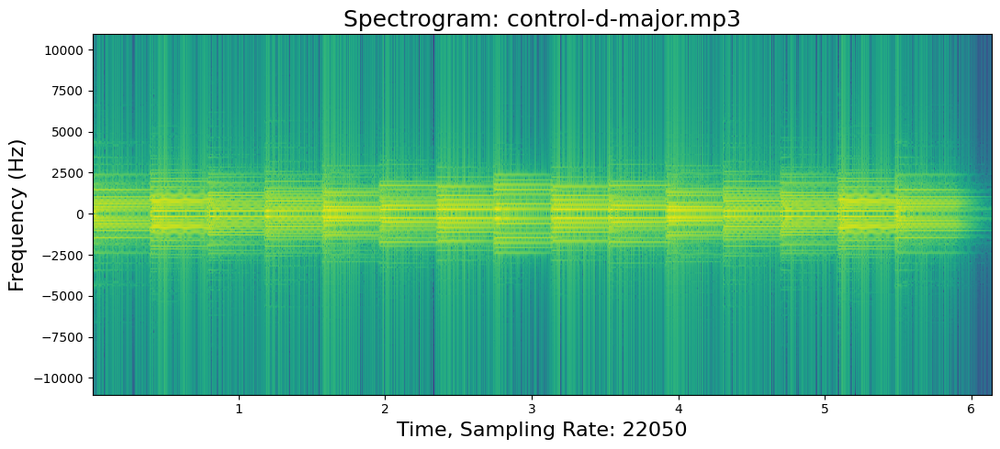

In [32]:
pluto.draw_spectrogram(pluto.audio_control_dmajor,
  window=matplotlib.mlab.window_none,
  sides='twosided')

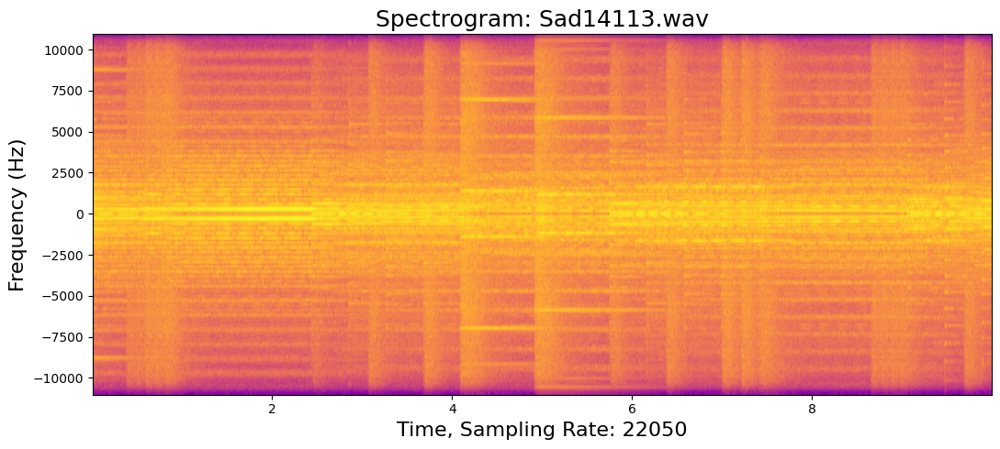

In [33]:
pluto.draw_spectrogram(pluto.df_music_data, 
  cmap='plasma',
  sides='twosided')

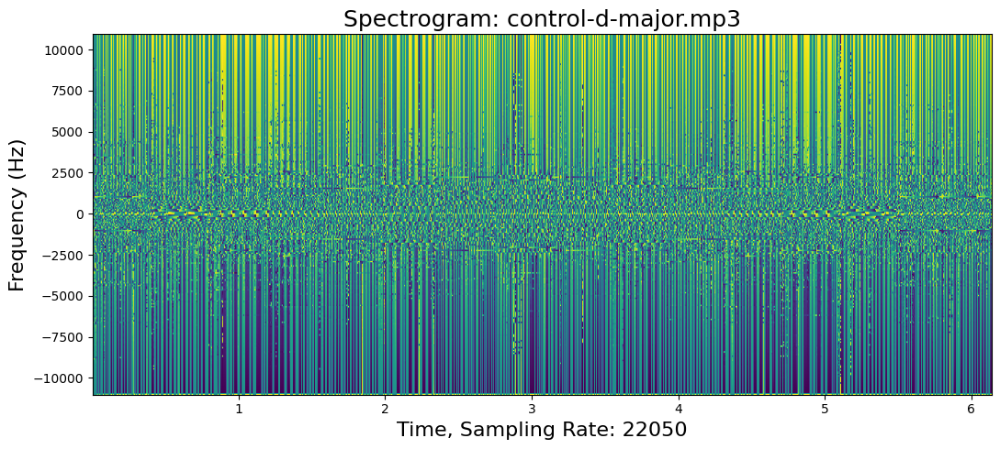

In [34]:
pluto.draw_spectrogram(pluto.audio_control_dmajor,
  window=matplotlib.mlab.window_none,
  sides='twosided',
  mode='angle')

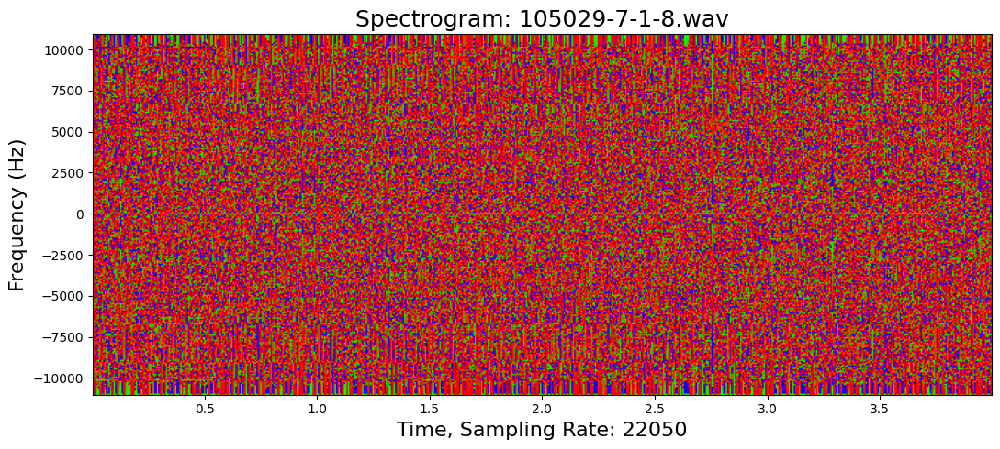

In [35]:
pluto.draw_spectrogram(pluto.df_sound_data,
  cmap='brg',
  window=matplotlib.mlab.window_none,
  sides='twosided',
  mode='angle')

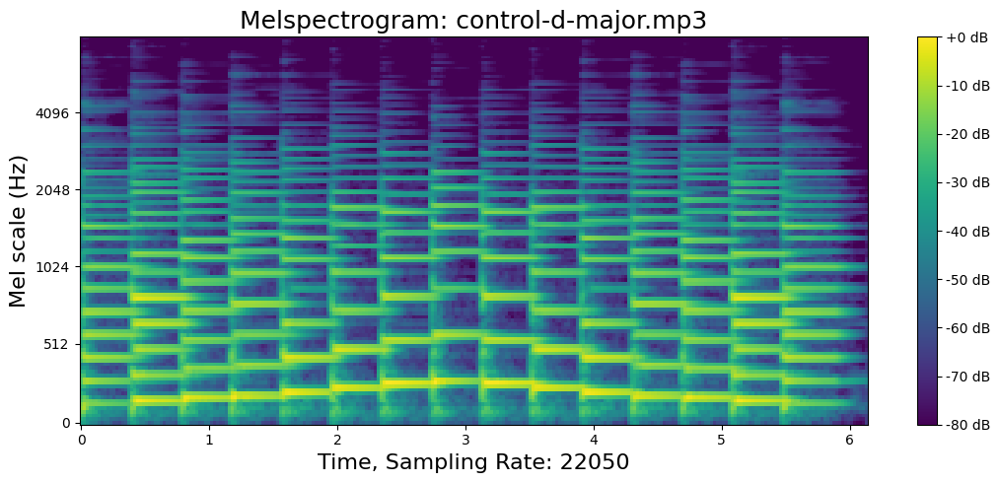

In [36]:
pluto.draw_melspectrogram(pluto.audio_control_dmajor)

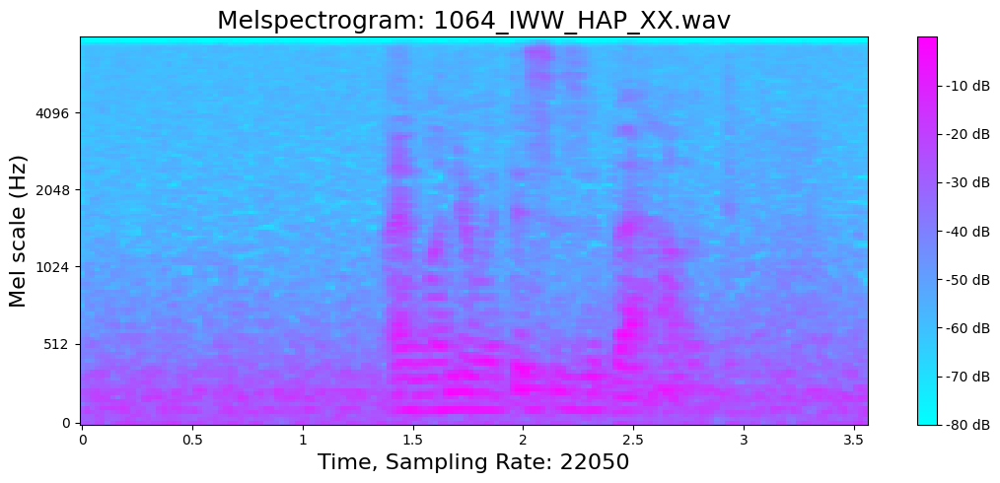

In [37]:
pluto.draw_melspectrogram(pluto.df_voice_data, cmap='cool')

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[-1.9005806e-06  1.0451000e-05  9.7864549e-06 ... -9.9641620e-06
  1.5720242e-04  0.0000000e+00] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


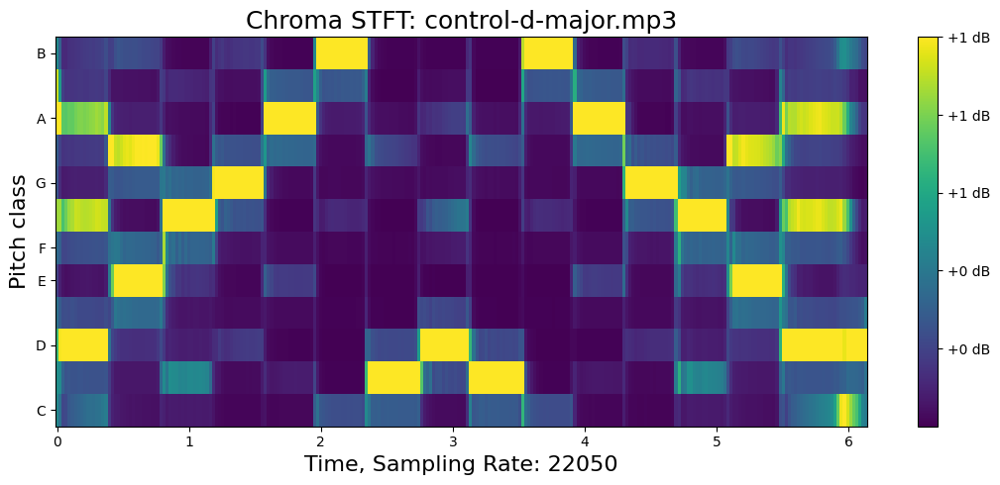

In [38]:
pluto.draw_melspectrogram(pluto.audio_control_dmajor, is_chroma=True)

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[3.9714161e-09 3.5202991e-08 3.9374061e-08 ... 5.0065264e-02 5.8913767e-02
 0.0000000e+00] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


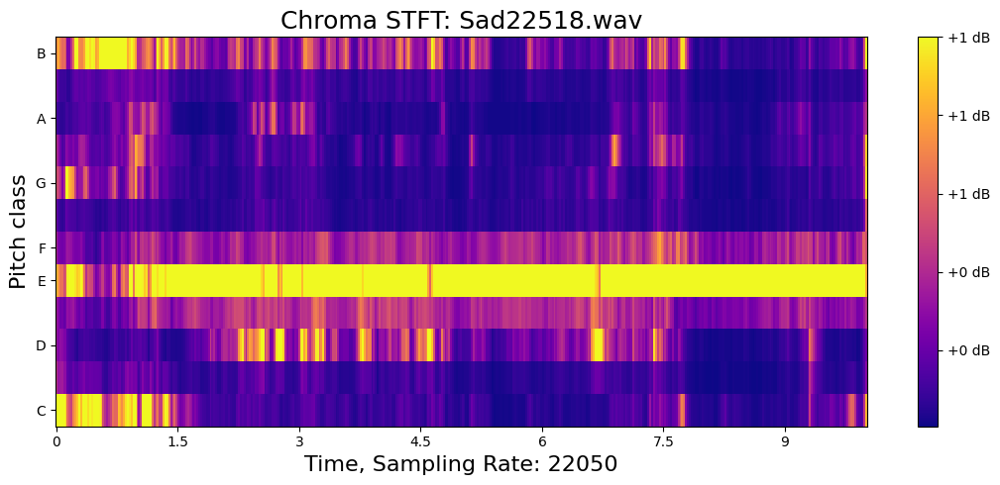

In [39]:
pluto.draw_melspectrogram(pluto.df_music_data, is_chroma=True, cmap='plasma')

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[0.00076666 0.00131462 0.00139605 ... 0.00916222 0.00848912 0.0080039 ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


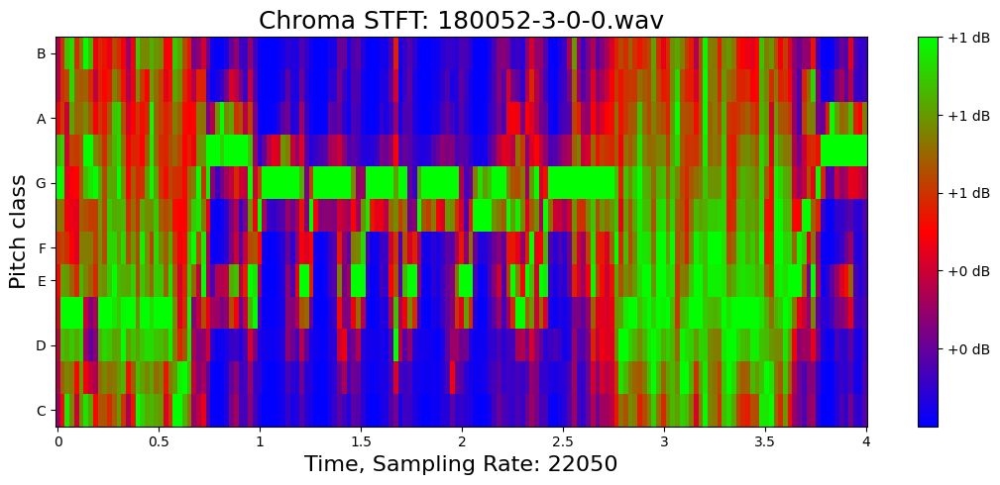

In [40]:
pluto.draw_melspectrogram(pluto.df_sound_data, is_chroma=True, cmap='brg')

# Time shift

In [41]:
# %CARRY-OVER

!pip install audiomentations
#
# tested on the following version:
# !pip install audiomentations==0.29.0 
# !pip install librosa==0.9.2

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [42]:
# %%writefile -a {pluto_chapter_7}

import audiomentations
#
@add_method(PacktDataAug)
def _fetch_1_sample(self, df, dsize=1):
  p = df.sample(dsize)
  p.reset_index(drop=True, inplace=True)
  return p.fname[0]
#
@add_method(PacktDataAug)
def _audio_transform(self, df, xtransform, title='',is_waveform=True):
  if (type(df) is list):
    data_amp, sam_rate, fname, lname = self.audio_control_dmajor
  else:
    lname = self._fetch_1_sample(df)
    data_amp, sam_rate, fname = self._fetch_audio_data(lname)
  #
  xaug = xtransform(data_amp, sample_rate=sam_rate)
  if (is_waveform):
    # augmented
    self._draw_audio(xaug, sam_rate, title + ' Augmented: ' + fname)
    display(IPython.display.Audio(xaug, rate=sam_rate))
    # original
    self._draw_audio(data_amp, sam_rate, 'Original: ' + fname)
  else:
    xdata = [xaug, sam_rate, fname, 'cat']
    self.draw_spectrogram(xdata)
    self.draw_melspectrogram(xdata)
    self.draw_melspectrogram(xdata,is_chroma=True)
  display(IPython.display.Audio(data_amp, rate=sam_rate))
  return 

In [43]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_time_shift(self, df, min_fraction=-0.2,
  max_fraction=0.8,rollover=True,title='Time Shift', is_waveform=True):
  xtransform = audiomentations.Shift(
    min_fraction = min_fraction,
    max_fraction = max_fraction,
    rollover = rollover,
    p=1.0
  )
  self._audio_transform(df, xtransform, title=title,is_waveform=is_waveform)
  return 

/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:345: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


/content/Data-Augmentation-with-Python/pluto/pluto_chapter_7.py:345: UserWarning: FixedFormatter should only be used together with FixedLocator
  pics[0].set_xticklabels(b)


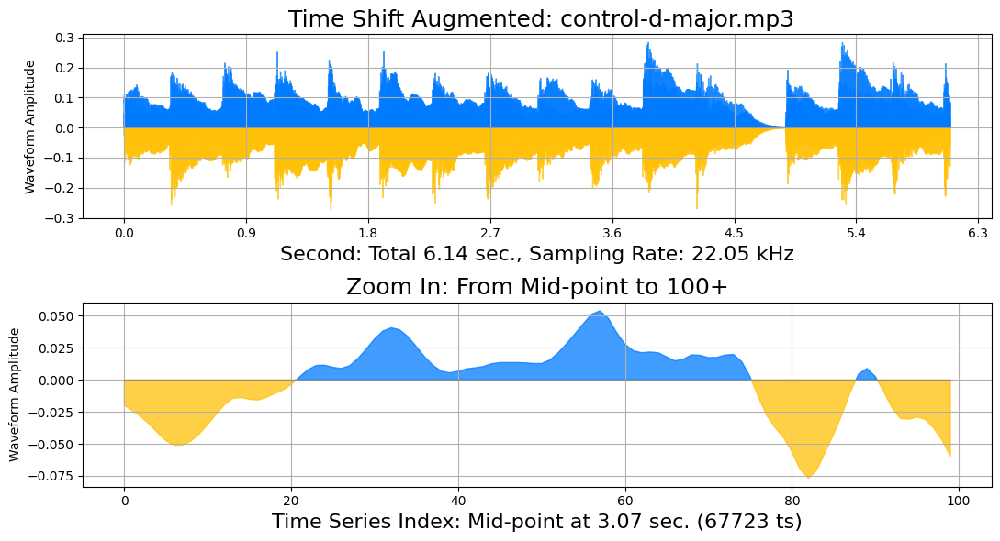

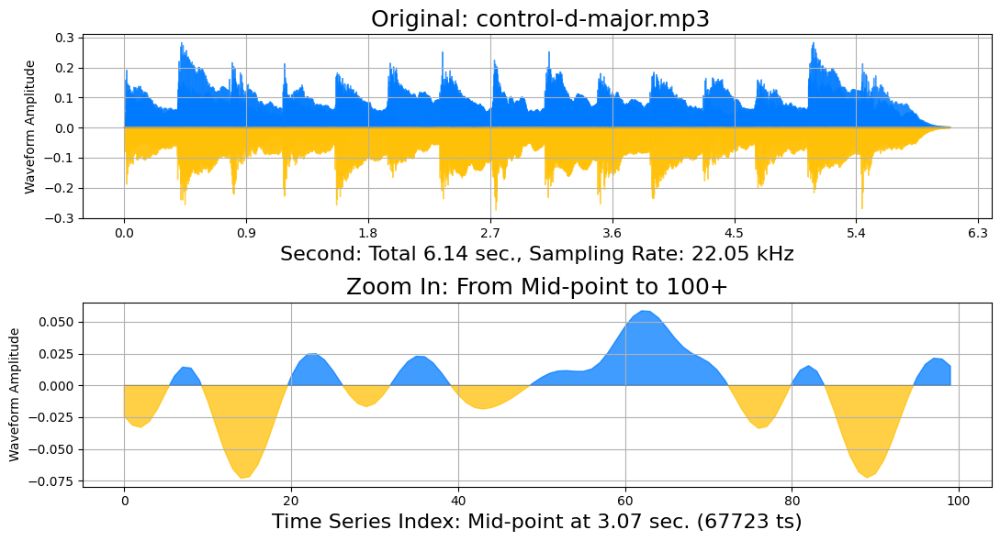

In [44]:
pluto.play_aug_time_shift(pluto.audio_control_dmajor, min_fraction=0.8)

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[0.02111726 0.02957842 0.03906368 ... 0.02387354 0.01738894 0.01625222] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


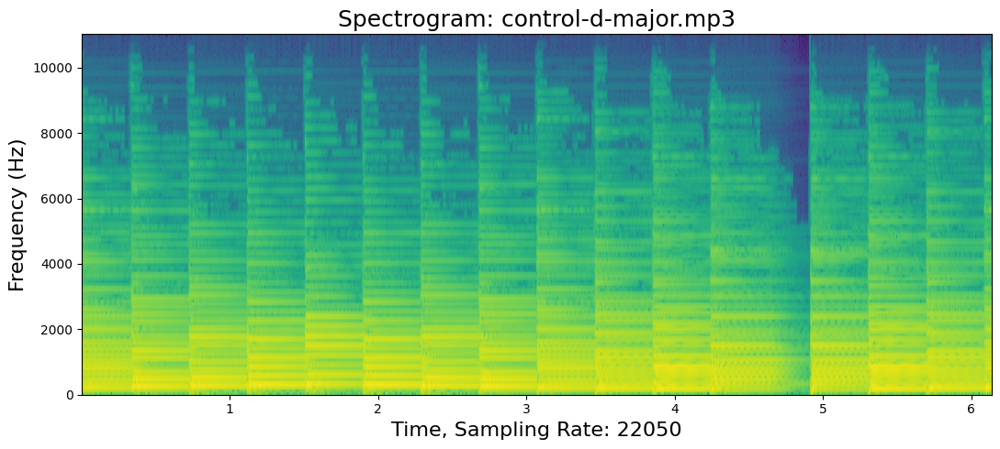

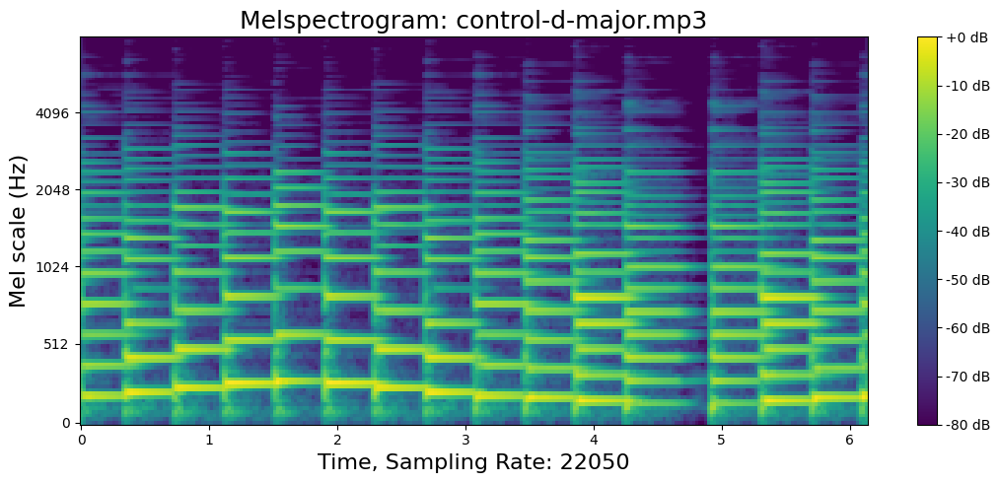

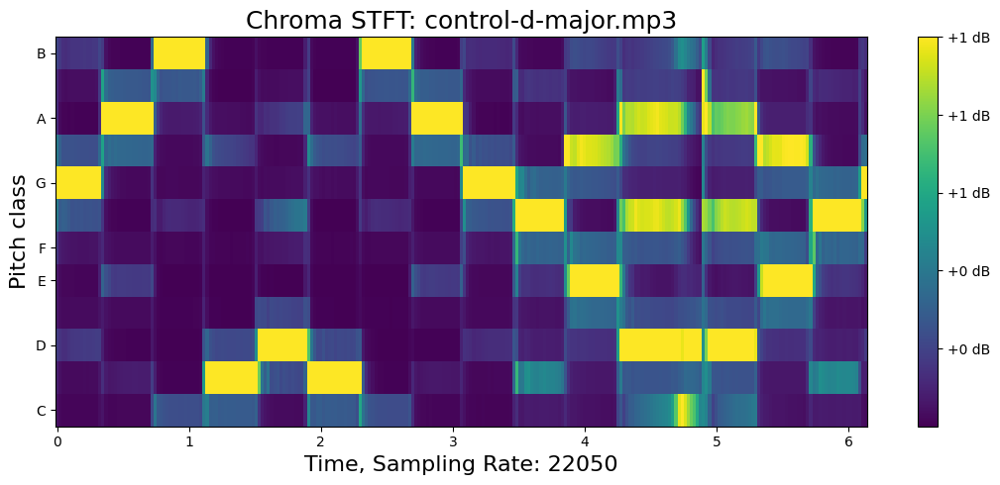

In [45]:
pluto.play_aug_time_shift(pluto.audio_control_dmajor, min_fraction=0.8, is_waveform=False)

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[0.02448728 0.02417788 0.02522012 ... 0.03797026 0.03185279 0.02614647] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


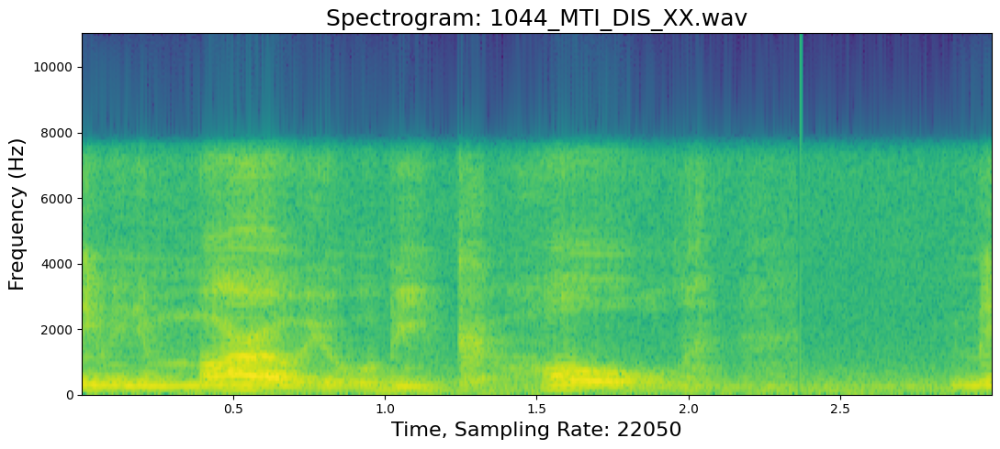

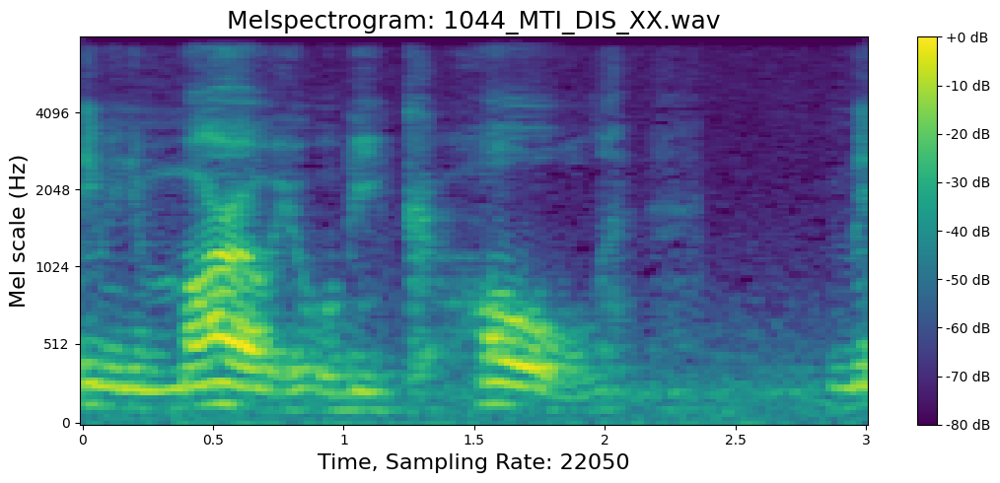

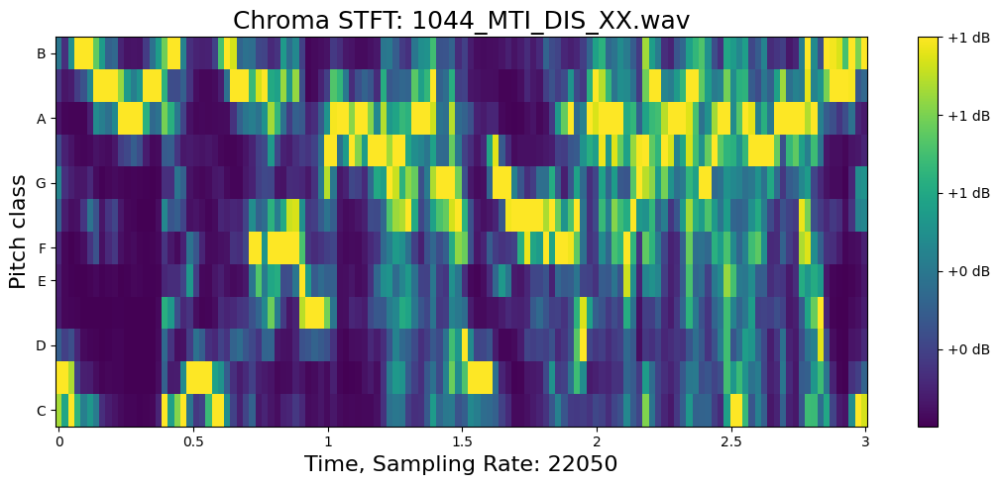

In [46]:
pluto.play_aug_time_shift(pluto.df_voice_data, min_fraction=0.6, is_waveform=False)

# Time stretch

In [47]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_time_stretch(self, df, min_rate=0.2,max_rate=6.8,
  leave_length_unchanged=True,title='Time Stretch',
  is_waveform=True):
  xtransform = audiomentations.TimeStretch(
    min_rate = min_rate,
    max_rate = max_rate,
    leave_length_unchanged = leave_length_unchanged,
    p=1.0
  )
  self._audio_transform(df, xtransform, title=title, is_waveform=is_waveform)
  return 
  # librosa.effects.time_stretch under the hood 

/usr/local/lib/python3.9/dist-packages/matplotlib/axes/_axes.py:7773: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[ 0.00460071  0.00194586 -0.00049819 ...  0.          0.
  0.        ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


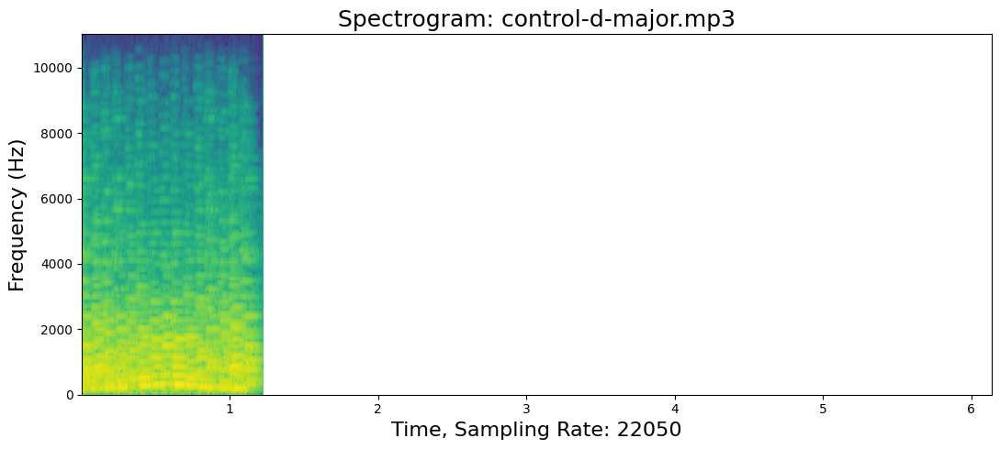

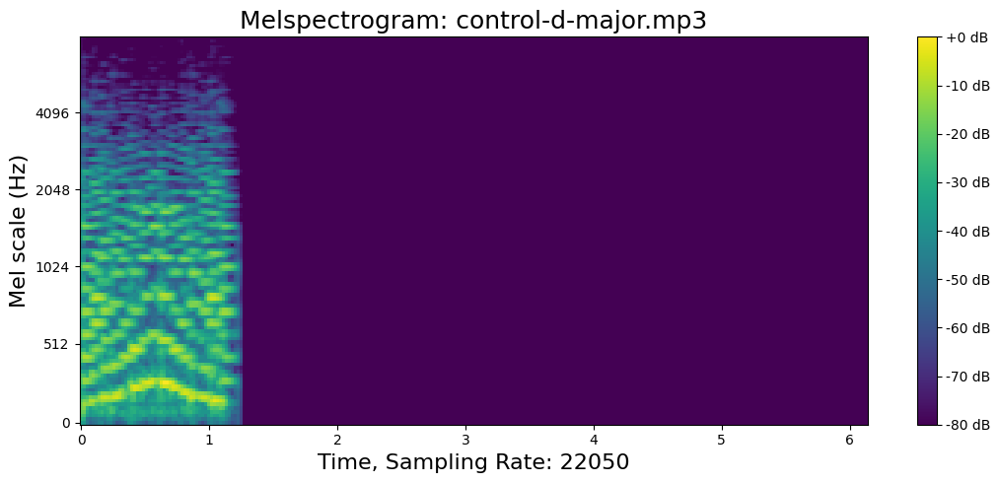

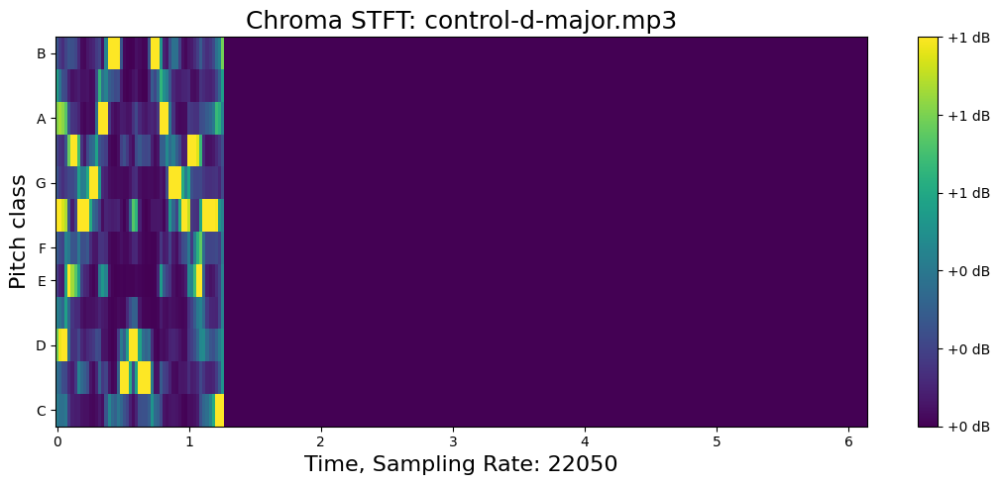

In [48]:
pluto.play_aug_time_stretch(pluto.audio_control_dmajor, max_rate=5.4, is_waveform=False)

In [49]:
# pluto.play_aug_time_stretch(pluto.df_music_data, max_rate=3.0)

/usr/local/lib/python3.9/dist-packages/matplotlib/axes/_axes.py:7773: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[0.00120182 0.0010732  0.00044386 ... 0.         0.         0.        ] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


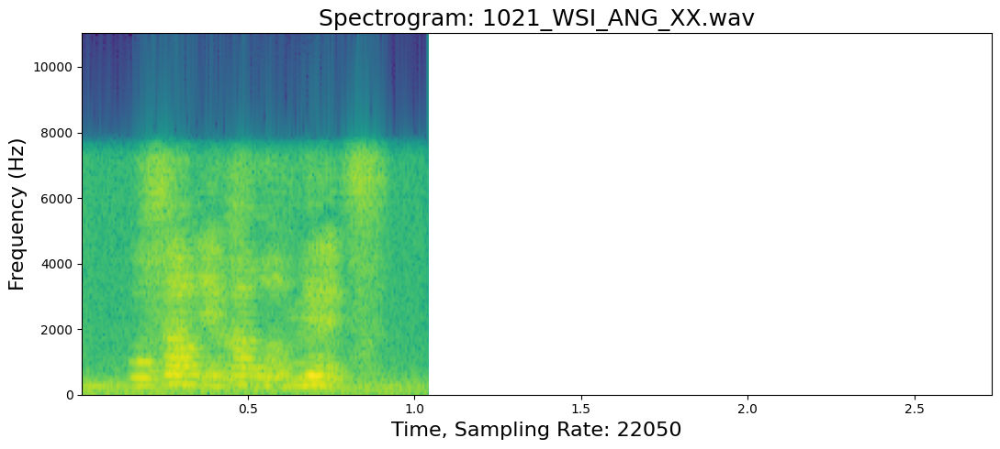

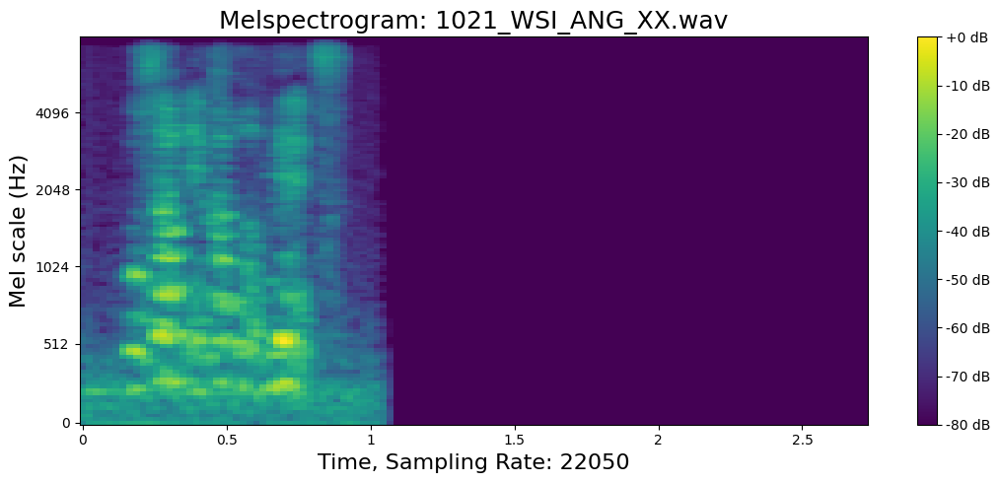

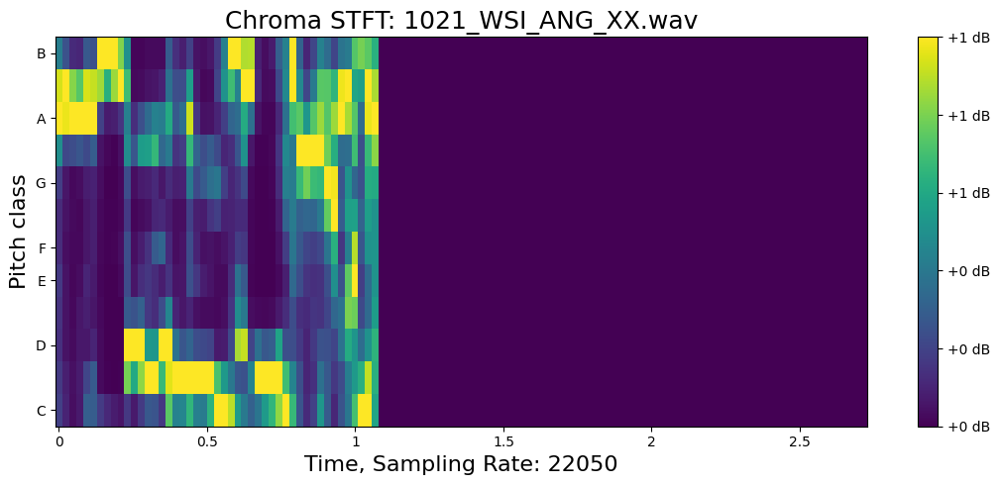

In [50]:
pluto.play_aug_time_stretch(pluto.df_voice_data, max_rate=3.5, is_waveform=False)

# Noise injection, add Gaussian noise

In [51]:
# %%writefile -a {pluto_chapter_7}

@add_method(PacktDataAug)
def play_aug_noise_injection(self, df, min_amplitude=0.002,
  max_amplitude=0.2,title='Gaussian noise injection',is_waveform=True):
  xtransform = audiomentations.AddGaussianNoise(
    min_amplitude = min_amplitude,
    max_amplitude = max_amplitude,
    p=1.0)
  self._audio_transform(df, xtransform, title=title, is_waveform=is_waveform)
  return

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[ 0.02769292  0.01316224 -0.05694102 ... -0.1110885   0.05800604
 -0.00611654] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


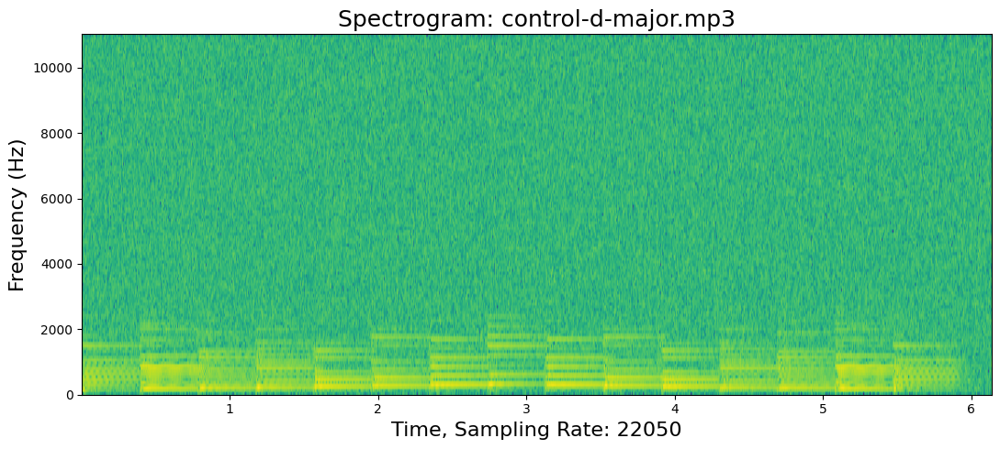

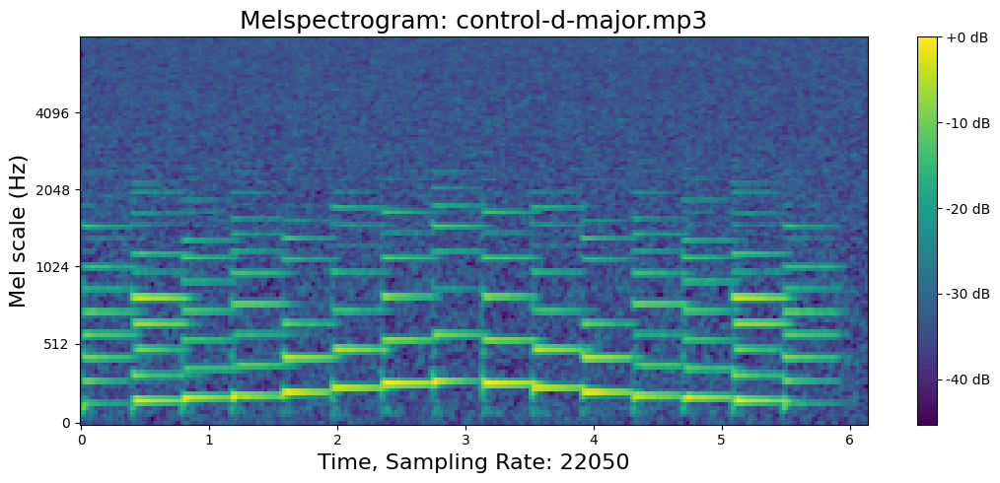

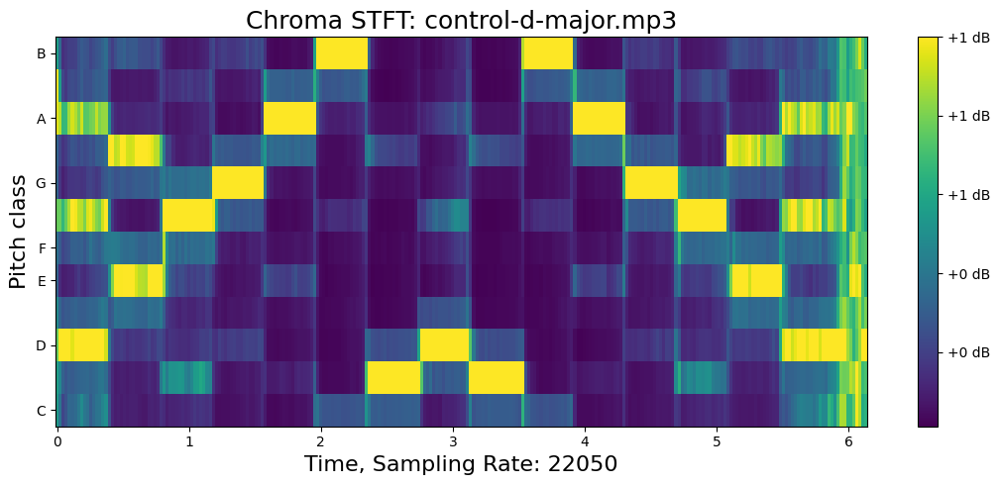

In [52]:
pluto.play_aug_noise_injection(pluto.audio_control_dmajor, 
  min_amplitude=0.02,max_amplitude=0.05,is_waveform=False)

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[ 0.00194339 -0.01053944  0.01085477 ...  0.03462062 -0.00434058
 -0.01223827] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


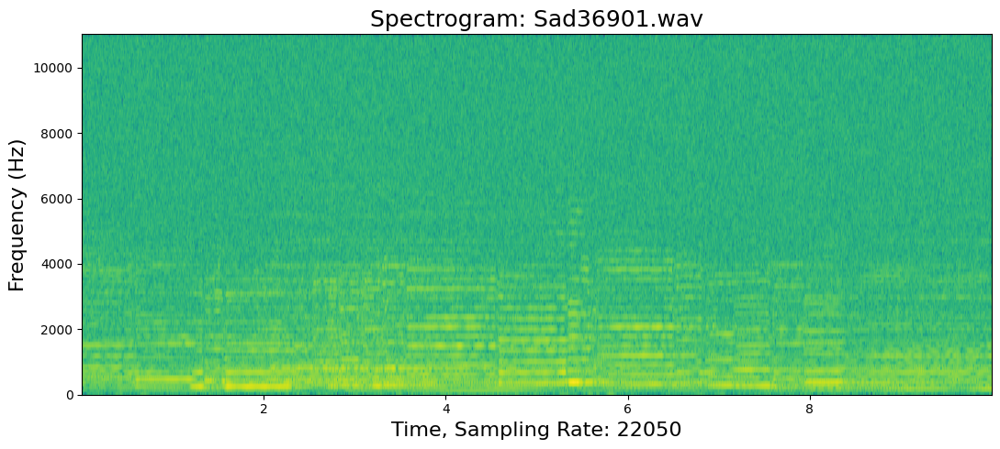

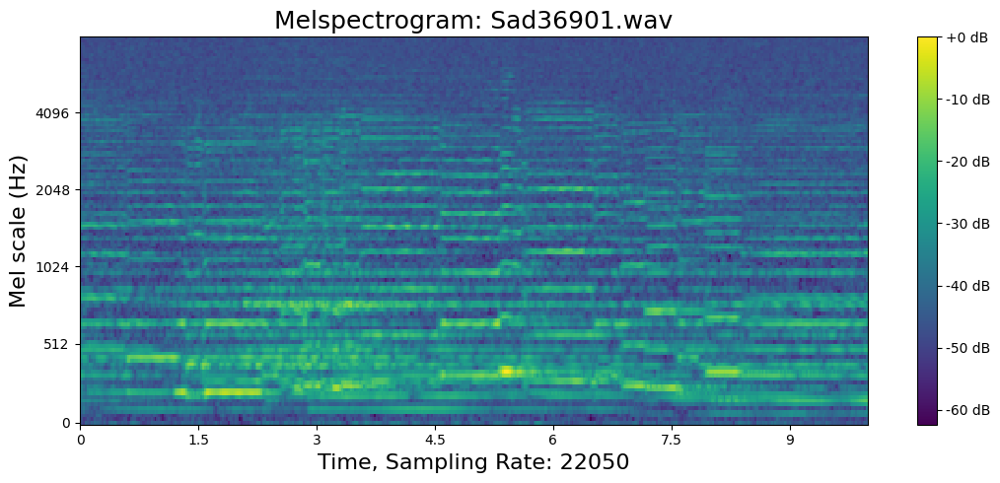

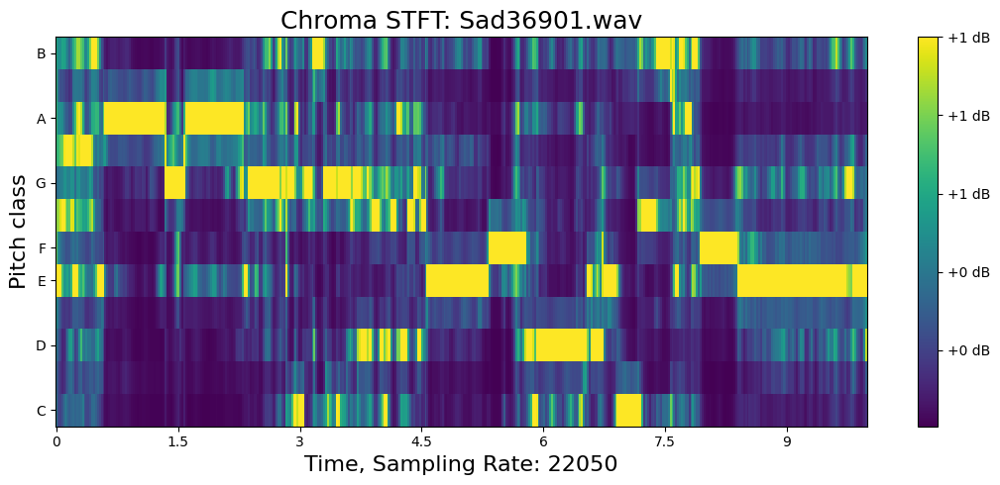

In [53]:
pluto.play_aug_noise_injection(pluto.df_music_data, 
  min_amplitude=0.008,max_amplitude=0.05,is_waveform=False)

<ipython-input-24-22bfdc38a2a2>:67: FutureWarning: Pass y=[-0.0496982  -0.01685216 -0.01561809 ... -0.00440137 -0.02334408
  0.00388706] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  mel_db = librosa.feature.chroma_stft(data_amp,


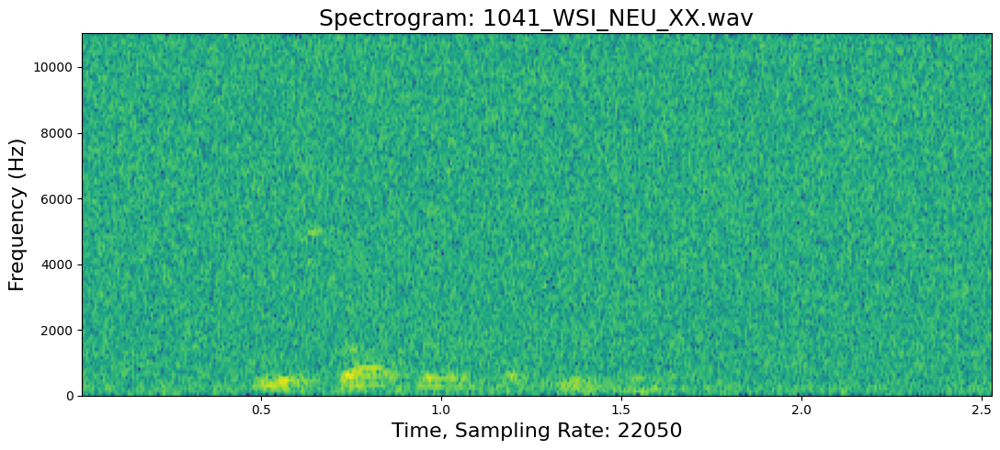

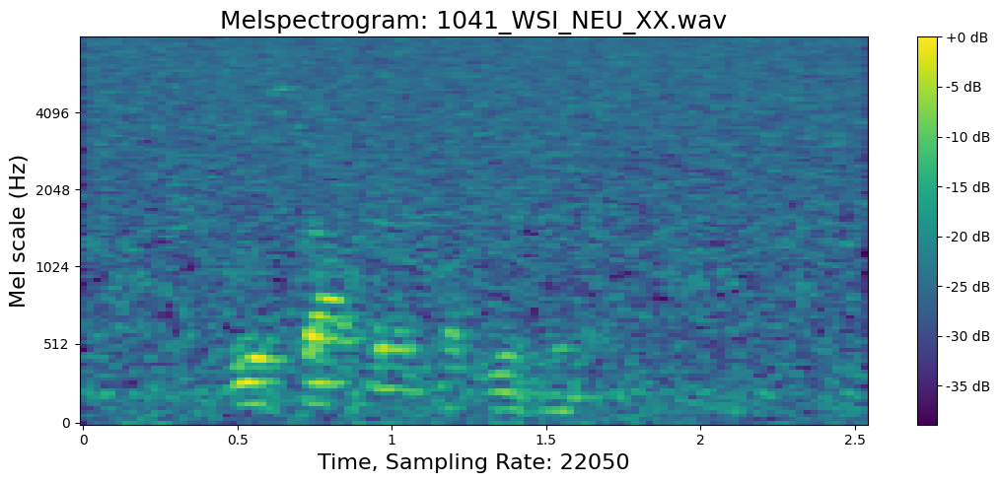

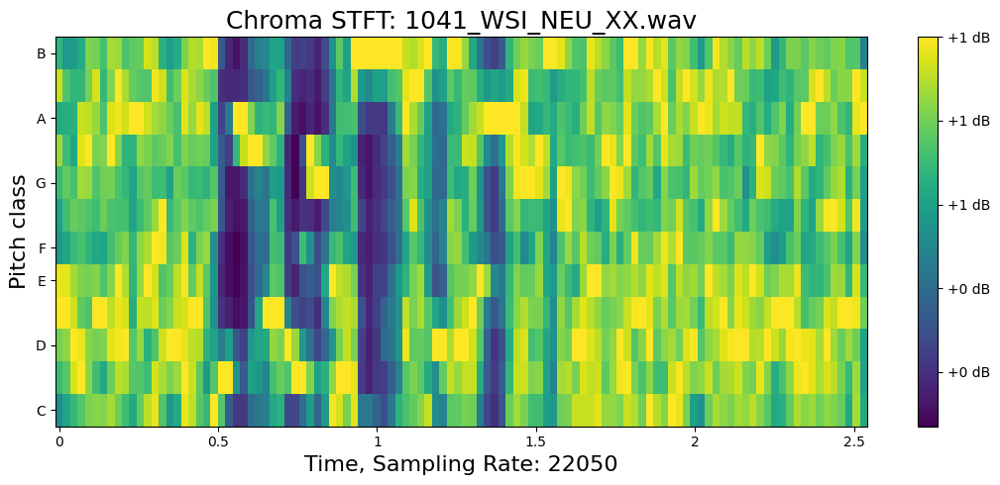

In [54]:
pluto.play_aug_noise_injection(pluto.df_voice_data, max_amplitude=0.05, is_waveform=False)

In [55]:
print('End of Chapter 8')

End of Chapter 8


# Push up all changes (Optional)

- username: duchaba

- password: [use the token]

In [ ]:
# import os
# f = 'Data-Augmentation-with-Python'
# os.chdir(f)
# !git add -A
# !git config --global user.email "duc.haba@gmail.com"
# !git config --global user.name "duchaba"
# !git commit -m "end of session"
# # do the git push in the xterm console
# #!git push

In [ ]:
# %%script false --no-raise-error  #temporary stop execute for export file

In [ ]:
# # compress/zip all the pluto generated images from this chapter for download
# f = 'pluto-img-'+str(pluto.fname_id)+'.zip'
# print(f)
# !zip {f} /content/Data-Augmentation-with-Python/pluto_img/*

# Summary 

Every chaper will begin with same base class "PacktDataAug".

✋ FAIR WARNING:

- The coding uses long and complete function path name.

- Pluto wrote the code for easy to understand and not for compactness, fast execution, nor cleaverness.

- Use Xterm to debug cloud server



In [ ]:
# !pip install colab-xterm
# %load_ext colabxterm
# %xterm